In [1]:
from urllib.request import urlopen
import json
import pandas as pd
import plotly.express as px

In [23]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

counties["features"][0]

{'type': 'Feature',
 'properties': {'GEO_ID': '0500000US01001',
  'STATE': '01',
  'COUNTY': '001',
  'NAME': 'Autauga',
  'LSAD': 'County',
  'CENSUSAREA': 594.436},
 'geometry': {'type': 'Polygon',
  'coordinates': [[[-86.496774, 32.344437],
    [-86.717897, 32.402814],
    [-86.814912, 32.340803],
    [-86.890581, 32.502974],
    [-86.917595, 32.664169],
    [-86.71339, 32.661732],
    [-86.714219, 32.705694],
    [-86.413116, 32.707386],
    [-86.411172, 32.409937],
    [-86.496774, 32.344437]]]},
 'id': '01001'}

In [24]:
CCVI = pd.read_csv("cases_ccvi.csv")

In [25]:
CCVI = CCVI[['countyFIPS','CCVI']]

In [26]:
CCVI.columns = ['fips','CCVI']

In [27]:
CCVI.astype({'fips':'str'}).dtypes

fips     object
CCVI    float64
dtype: object

In [28]:
CCVI.head()

,fips,CCVI
0,10001,0.295447
1,10003,0.196116
2,10005,0.341293
3,11001,0.204712
4,12001,0.136262


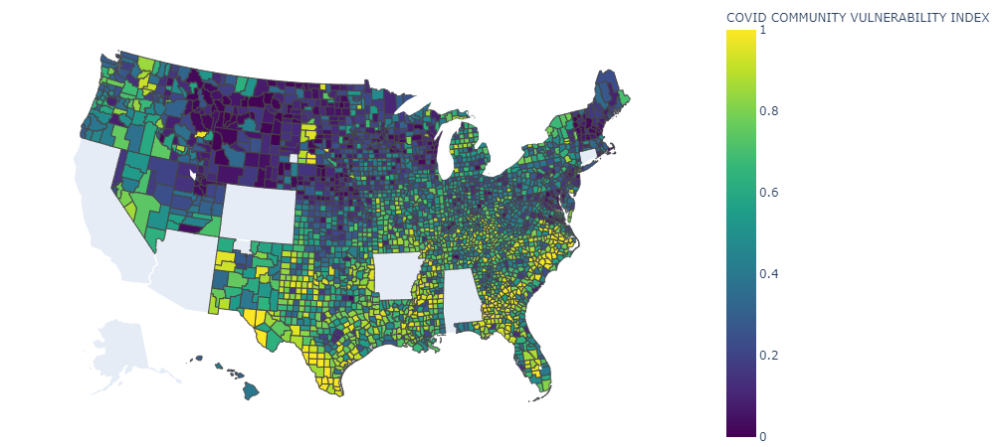

In [29]:
fig = px.choropleth(CCVI, geojson=counties, locations='fips', color='CCVI',
                           color_continuous_scale="Viridis",
                           range_color=(0, 1),
                           scope="usa",
                           labels={'CCVI':'COVID COMMUNITY VULNERABILITY INDEX'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [45]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

In [48]:
df.dtypes

fips      object
unemp    float64
dtype: object

In [49]:
df

,fips,unemp
0,01001,5.3
1,01003,5.4
2,01005,8.6
3,01007,6.6
4,01009,5.5
...,...,...
3214,72145,13.9
3215,72147,10.6
3216,72149,20.2
3217,72151,16.9


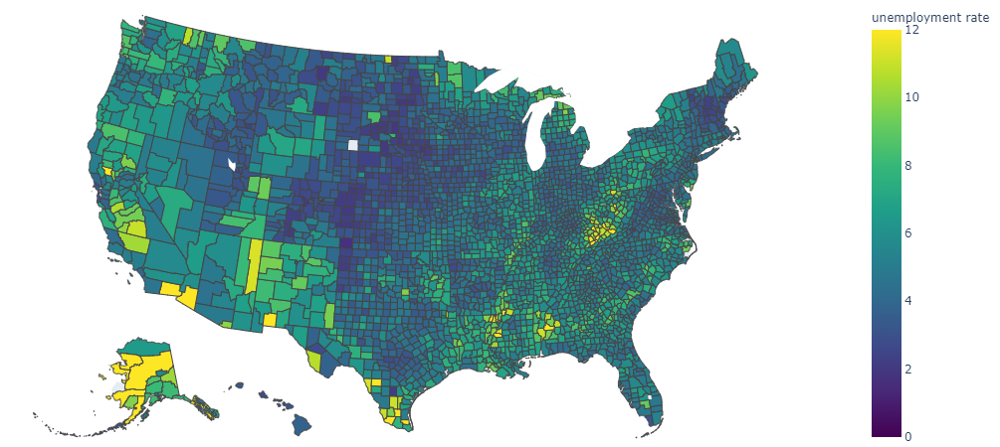

In [50]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

import plotly.express as px

fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()